### Model Dependencies

In [1]:
# pipeline modules
import pickle
import numpy as np
import cv2
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import os
%matplotlib inline
import math
from moviepy.editor import VideoFileClip
from numpy.linalg import inv

### Helper Functions and Objects

In [8]:
# line class is used to store and track values from left and right lines found in each frame
class Line():
    def __init__(self):
        #prior base position
        self.last_base_x = None
        # was the line detected in the last iteration?
        self.detected = False  
        # x values of the last n fits of the line
        self.recent_xfitted = [] 
        #average x values of the fitted line over the last n iterations
        self.bestx = None     
        #polynomial coefficients averaged over the last n iterations
        self.best_fit = None  
        #polynomial coefficients for the most recent fit
        self.current_fit = [np.array([False])]  
        #radius of curvature of the line in some units
        self.radius_of_curvature = None 
        #distance in meters of vehicle center from the line
        self.line_base_pos = None 
        #difference in fit coefficients between last and new fits
        self.diffs = np.array([0,0,0], dtype='float') 
        #x values for detected line pixels
        self.allx = None  
        #y values for detected line pixels
        self.ally = None

In [95]:
#Camera calibration
def cameraCalib(filename):
    # list files in the provided directory (checkerboard images)
    files = os.listdir(filename)
    
    # instantiate arrays to hold object and image points
    objPoints = []
    imgPoints = []

    
    # create an object space grid for mapping image points
    objp = np.zeros((6*9,3),np.float32)
    objp[:,:2]=np.mgrid[0:9,0:6].T.reshape(-1,2)
    
    # loop through checkerboard files
    for f in files:
        # open the image
        img = mpimg.imread(filename+f)
        # convert the image to gray
        gray = cv2.cvtColor(img,cv2.COLOR_RGB2GRAY)
    
        # find the corners
        ret, corners = cv2.findChessboardCorners(gray, (9,6),None)
        
        # append corners to data set along with a copy of the object points grid
        if ret == True:
            imgPoints.append(corners)
            objPoints.append(objp)
    # return image and object points
    return imgPoints,objPoints

In [94]:
# masking function (not used for final model)
def region_of_interest(img, vertices):
 
    #defining a blank mask to start with
    mask = np.zeros_like(img)   
    ignore_mask_color = 255
        
    #filling pixels inside the polygon defined by "vertices" with the fill color    
    cv2.fillPoly(mask, vertices, ignore_mask_color)
    
    #returning the image only where mask pixels are nonzero
    masked_image = cv2.bitwise_and(img, mask)
    return masked_image

In [93]:
#Distortion correction
def undistort_image(gray):
    # apply cv2 camera calibration function
    # requires global object and imagepoint objects
    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objp, imp, gray.shape[::-1],None,None)
    
    # use camera calibration coefs to generate an undistorted version of the image
    dst = cv2.undistort(gray, mtx, dist, None, mtx)
    return dst

In [92]:
#Color thresholds
def s_select(img, thresh=(90, 255)):
    # convert the image to HLS
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    # select the s channel
    s_channel = hls[:,:,2]
    # create a placeholder for the image
    binary_output = np.zeros_like(s_channel)
    # apply s channel thresholds
    binary_output[(s_channel > thresh[0]) & (s_channel <= thresh[1])] = 1
    return binary_output

def h_select(img, thresh=(15, 100)):
    # convert the image to HLS
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    # select the h channel
    h_channel = hls[:,:,0]
    # create a placeholder for the binary image
    binary_output = np.zeros_like(h_channel)
    # apply s channel thresholds
    binary_output[(h_channel > thresh[0]) & (h_channel <= thresh[1])] = 1
    return binary_output

In [91]:
#gradient threshold functions
# code is borrowed from samples covered in class
# all functions take a grayscale image as input
def abs_sobel_thresh(gray, orient='x', thresh_min=0, thresh_max=255):
    # Apply x or y gradient with the OpenCV Sobel() function
    # and take the absolute value
    if orient == 'x':
        abs_sobel = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 1, 0))
    if orient == 'y':
        abs_sobel = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 0, 1))
    # convert the image to 8 bit integer
    scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))
    # Create a copy of the image
    binary_output = np.zeros_like(scaled_sobel)
   
    binary_output[(scaled_sobel >= thresh_min) & (scaled_sobel <= thresh_max)] = 1

    # Return the result
    return binary_output

# function filters on gradient magnitude
def mag_thresh(gray, sobel_kernel=3, mag_thresh=(0, 255)):
    
    # Take both Sobel x and y gradients using cv2 functions
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # Calculate the gradient magnitude
    gradmag = np.sqrt(sobelx**2 + sobely**2)
    # convert the image to 8 bit integer
    scale_factor = np.max(gradmag)/255 
    gradmag = (gradmag/scale_factor).astype(np.uint8) 
   
    # create a new image of the same size and apply the thresholds to create a binary output
    binary_output = np.zeros_like(gradmag)
    binary_output[(gradmag >= mag_thresh[0]) & (gradmag <= mag_thresh[1])] = 1

    # Return the binary image
    return binary_output

# Filters image based on gradient direction
def dir_threshold(gray, sobel_kernel=3, thresh=(0, np.pi/2)):
    # Calculate the x and y gradients
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # Take the absolute value of the gradient direction, 
    # apply a threshold, and create a binary image result
    absgraddir = np.arctan2(np.absolute(sobely), np.absolute(sobelx))
    binary_output =  np.zeros_like(absgraddir)
    binary_output[(absgraddir >= thresh[0]) & (absgraddir <= thresh[1])] = 1

    # Return the binary image
    return binary_output

In [90]:
# Function is used to unwarp an image
def corners_unwarp(img):

    offset = 100 # offset for dst points
    # Grab the image shape
    img_size = (img.shape[1], img.shape[0])
    
    # source points
    src = np.float32([(250,700), (520,500),(775,500),(1080,700)])

    #destination points
    dst = np.float32([[200,700], [200, 200],[1100,100], [1100,700]])
    
    #use cv2.getPerspectiveTransform() to get M, the transform matrix
    M = cv2.getPerspectiveTransform(src, dst)
    # e) use cv2.warpPerspective() to warp your image to a top-down view
    warped = cv2.warpPerspective(img, M, img_size)
    return warped, M

In [96]:
def first_frame_window(top_down):
    # Take a histogram of the bottom half of the image
    histogram = np.sum(top_down[top_down.shape[0]/2:,:], axis=0)
    # Create an output image to draw on and  visualize the result
    out_img = np.dstack((top_down, top_down, top_down))*255
   
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]/2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint
   
    # Choose the number of sliding windows
    nwindows = 9
    # Set height of windows
    window_height = np.int(top_down.shape[0]/nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = top_down.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated for each window
    leftx_current = leftx_base
    rightx_current = rightx_base
    # Set the width of the windows +/- margin
    margin = 100
    # Set minimum number of pixels found to recenter window
    minpix = 50
    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []
    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = top_down.shape[0] - (window+1)*window_height
        win_y_high = top_down.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),(0,255,0), 2) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),(0,255,0), 2) 
        # Identify the nonzero pixels in x and y within the window
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xleft_low) & (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xright_low) & (nonzerox < win_xright_high)).nonzero()[0]
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))
    # Concatenate the arrays of indices
    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds] 

    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    return leftx_base,rightx_base,left_fit,right_fit,left_lane_inds,right_lane_inds,nonzeroy,nonzerox

In [97]:
def findLines_nextFrame(img,left_fit,right_fit):
    nonzero = img.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    margin = 100
    left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + left_fit[2] - margin)) & (nonzerox < (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + left_fit[2] + margin))) 
    right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + right_fit[2] - margin)) & (nonzerox < (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + right_fit[2] + margin)))  

    # Again, extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]
    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
   
    return left_fit, right_fit,nonzeroy,nonzerox

In [98]:
def getCurve(leftx,rightx,ploty):
    # Define conversions in x and y from pixels space to meters
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meters per pixel in x dimension
    leftx = leftx[::-1]
    rightx = rightx[::-1]
    
    y_eval = np.max(ploty)
    # Fit new polynomials to x,y in world space
    left_fit_cr = np.polyfit(ploty*ym_per_pix, leftx*xm_per_pix, 2)
    right_fit_cr = np.polyfit(ploty*ym_per_pix, rightx*xm_per_pix, 2)
    # Calculate the new radii of curvature
    left_curverad = ((1 + (2*left_fit_cr[0]*y_eval*ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
    right_curverad = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])
    # Now our radius of curvature is in meters
    return left_curverad,right_curverad

In [99]:
def fitLanes(top_down,left_base,right_base,left_fit,right_fit,quadratic_coeff = 3e-4):
    # Generate x and y values for plotting
    ploty = np.linspace(0, top_down.shape[0]-1, top_down.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    

    # generate data points along lanes
    leftx = np.array([left_base + (y**2)*quadratic_coeff + np.random.randint(-50, high=51) 
                                  for y in ploty])
    rightx = np.array([right_base + (y**2)*quadratic_coeff + np.random.randint(-50, high=51) 
                                    for y in ploty])
    return ploty,left_fitx,right_fitx,leftx,rightx

In [100]:
def paint_laneLines(top_down,img,undist,left_fitx,right_fitx,ploty,m):
    # Create an image to draw the lines on
    warp_zero = np.zeros_like(top_down).astype(np.uint8)
    color_warp = np.dstack((top_down, top_down, top_down))

    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))

    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(color_warp, inv(m), (img.shape[1], img.shape[0])) 
    # Combine the result with the original image
    result = cv2.addWeighted(img, 1, newwarp, 0.3, 0)
    return result 

In [101]:
# update the lane findings to use average fits and x
def processFrame(img,left,right,first = False):
    # apply image filters to image
    undist,filteredImg = applyFilters(img)
    leftLine = left
    rightLine = right
    # grab the last positions and best fits
    lastLeft_base = leftLine.last_base_x
    lastRight_base = rightLine.last_base_x
    lastLeft_fit = leftLine.best_fit
    lastRight_fit = rightLine.best_fit
    
    # unwarp the image
    top_down, perspective_M = corners_unwarp(filteredImg)
    
    reprocess = False
    if first:
        left_base,right_base,left_fit,right_fit,left_lane_inds,right_lane_inds,nonzeroy,nonzerox = first_frame_window(top_down)
        ploty,left_fitx,right_fitx,leftx,rightx = fitLanes(top_down,left_base,right_base,left_fit,right_fit)
        
    else:
        try:
            left_fit,right_fit,nonzeroy,nonzerox = findLines_nextFrame(top_down,lastLeft_fit,lastRight_fit)
            ploty,left_fitx,right_fitx,leftx,rightx = fitLanes(top_down,lastLeft_base,lastRight_base,left_fit,right_fit)
            #print("fast analyze ....")
            # avlidate the line if any conditions fail, rerun the line search

            # get the last and first index of the left and right fits,
            firstLeft = left_fitx[0]
            lastLeft = left_fitx[-1]
            firstRight = right_fitx[0]
            lastRight = right_fitx[-1]
            #check to see if they are parrallell
            topDist = abs(lastLeft - lastRight)
            #print("Top Dist -> "+str(topDist))
            bottomDist = abs(firstLeft - firstRight)
            #print("Bottom DIst -> "+str(bottomDist))
            parDiff = abs(bottomDist - topDist)
            if parDiff > 110:
                reprocess = True
                #print("Par issue...")
            #check to see if distance is within range
            if abs(890-(firstRight-firstLeft)) > 70:
                reprocess = True
                #print("lane dist issue ...")
                #print(abs(890-(firstRight-firstLeft)))
            #check to see if base is in same position as others
            if abs(firstLeft-lastLeft_base)/lastLeft_base > .2:
                reprocess = True
                #print ("base issue...")
            if abs(firstRight-lastRight_base)/lastRight_base > .2:
                reprocess = True
                #print("base issue ...")
        except:
            reprocess = True
    
    # check to see if the lines need to be reprocessed using full search
    if reprocess:
        #print("had to reprocess....")
        left_base,right_base,left_fit,right_fit,left_lane_inds,right_lane_inds,nonzeroy,nonzerox = first_frame_window(top_down)
        ploty,left_fitx,right_fitx,leftx,rightx = fitLanes(top_down,left_base,right_base,left_fit,right_fit)
    # get the last and first index of the left and right fits,
    firstLeft = left_fitx[0]
    lastLeft = left_fitx[-1]
    firstRight = right_fitx[0]
    lastRight = right_fitx[-1]
        

    leftCurve,rightCurve = getCurve(leftx,rightx,ploty)
    vehPos = find_veh_pos(firstLeft,firstRight,img.shape[1])
    final = paint_laneLines(top_down,img,undist,left_fitx,right_fitx,ploty,perspective_M)
    
        # generate a left line
    leftLine.last_base_x = firstLeft
    leftLine.allx = leftx
    leftLine.current_fit = left_fit
    leftLine.recent_xfitted =left_fitx
    leftLine.line_base_pos = vehPos
    leftLine.radius_of_curvature = rightCurve
    
    rightLine.last_base_x = firstRight
    rightLine.allx = rightx
    rightLine.current_fit = right_fit
    rightLine.recent_xfitted =right_fitx
    rightLine.line_base_pos = vehPos
    rightLine.radius_of_curvature = rightCurve
    
    return leftLine,rightLine,final

In [102]:
# funct used to coordinate movie processing
def processMovie(img):
    # generate new line objects for the new frame
    left,right = createNewLines(leftLines,rightLines)
    
    # if the tracking list is less than 5 lines, process the image using deep search
    # if the tracking list is greater than 5 lines, allow the frame processing to use the shallow search method
    if len(leftLines)>=5:
        # process the image and update the left and right lane objects
        left,right,newImg = processFrame(img,left,right)
    else:
        # process the image and update the left and right lane objects
        left,right,newImg = processFrame(img,left,right,first=True)

    # store the lines
    leftLines.append(left)
    rightLines.append(right)

    # grab the road curve
    curve = left.radius_of_curvature
    # grab the vehicle position
    vehPos = left.line_base_pos
    # add the vehicle position and curve to the image as text
    imgText = "The vehicle is "+str(round(vehPos,3))+"m right of center."
    font = cv2.FONT_HERSHEY_SIMPLEX
    cv2.putText(newImg,imgText,(1,100), font, 2,(255,255,255),2,cv2.LINE_AA)
    imgText = "Lane urve of "+str(round(curve*.001,4))+"km."
    cv2.putText(newImg,imgText,(1,150), font, 2,(255,255,255),2,cv2.LINE_AA)
    # return the processed frame
    return newImg

In [64]:
# calculates an average fit coefficient given the last n lines in an array
def avgFitCoef(left,right):
    avgLeft = np.average(np.asarray(left),axis=0)
    avgRight = np.average(np.asarray(right),axis=0)
    return avgLeft,avgRight

In [65]:
# calculates an average x point list for each lane give the last n lines in an array
def avgFitX(left,right):
    avgLeft = np.average(np.asarray(left),axis=0)
    avgRight = np.average(np.asarray(right),axis=0)
    return avgLeft,avgRight

In [66]:
def createNewLines(leftLines,rightLines):
    # create line objects to hold the new line
    left = Line()
    right = Line()
    
    # check to see if the lane list contains enough line objects to calculate averages
    # return an empty lane if not
    if len(leftLines)>=5:
        # store the last line base position for fast search
        left.last_base_x = leftLines[-1].last_base_x
        right.last_base_x = rightLines[-1].last_base_x
        
        # grab the last 5 left and right lines to calc moving avverages
        lastNLeft = leftLines[-5:]
        lastNRight = rightLines[-5:]
        # add fits and x coordinates to arrays
        leftCurrFit = [lastNLeft[0].current_fit,lastNLeft[1].current_fit,lastNLeft[2].current_fit,
                       lastNLeft[3].current_fit,lastNLeft[4].current_fit]
        rightCurrFit = [lastNRight[0].current_fit,lastNRight[1].current_fit,lastNRight[2].current_fit,
                       lastNRight[3].current_fit,lastNRight[4].current_fit]
        leftRecX = [lastNLeft[0].recent_xfitted,lastNLeft[1].recent_xfitted,lastNLeft[2].recent_xfitted,
                       lastNLeft[3].recent_xfitted,lastNLeft[4].recent_xfitted]
        rightRecX = [lastNRight[0].recent_xfitted,lastNRight[1].recent_xfitted,lastNRight[2].recent_xfitted,
                       lastNRight[3].recent_xfitted,lastNRight[4].recent_xfitted]

        # calculate the average best fit coefficients and best x coordinate fits for the lines
        leftBestFit, rightBestFit = avgFitCoef(leftCurrFit,rightCurrFit)
        leftBestX, rightBestX = avgFitX(leftRecX,rightRecX)                                               
        
        # add average fits to the line object
        left.best_fit=leftBestFit
        right.best_fit=rightBestFit
        left.bestx = leftBestX
        right.bestx=rightBestX
    # return instantiated objects
    return left,right

In [67]:
# function to locate the vehicles position relative to the center line
def find_veh_pos(left_base,right_base,imgWidth):
    xm_per_pix = 3.7/700.0 # meters per pixel in x dimension
    # determine the center of the camera image
    imgCenter = float(imgWidth)/2.0
    # identify the lane width
    laneWidth = right_base-left_base
    # find the lane center
    laneCenter = left_base+(float(laneWidth)/2.0)
    # find position of vehicle relative to lane center assuming camera is centered on vehicle
    # translate image pixels to meters
    posToCenter = (laneCenter-imgCenter)*xm_per_pix
    # return vehicle position
    return posToCenter

In [68]:
# the function is used to filter, transform, and paint lane lines on a single image for testing
def processImage(img):
     # apply image filters to image
    undist,filteredImg = applyFilters(img)
    # unwarp the image to create a top down perspective
    top_down, perspective_M = corners_unwarp(filteredImg)
    # find the lane lines using deep search
    left_base,right_base,left_fit,right_fit,left_lane_inds,right_lane_inds,nonzeroy,nonzerox = first_frame_window(top_down)
    # fit a poltynomial to the lane lines
    ploty,left_fitx,right_fitx,leftx,rightx = fitLanes(top_down,left_base,right_base,left_fit,right_fit)
     
    # get the last and first index of the left and right fits,
    firstLeft = left_base
    lastLeft = left_fitx[-1]
    firstRight = right_base
    lastRight = right_fitx[-1]
    # calculate the curvature
    leftCurve,rightCurve = getCurve(leftx,rightx,ploty)
    # calculate the vehicle position
    vehPos = find_veh_pos(firstLeft,firstRight,img.shape[1])
    # paint the lanes on the original image
    final = paint_laneLines(top_down,img,undist,left_fitx,right_fitx,ploty,perspective_M)
    # return the updated image with lane lines as well as position and curve calculations
    return leftCurve,vehPos,final

In [70]:
# apply the filters that will be used to detect lines
def applyFilters(img):
    # convert the image to grayscale
    gray = cv2.cvtColor(img,cv2.COLOR_RGB2GRAY)
    # correct the image for camera distortion
    undist = undistort_image(gray)
    imshape = undist.shape
    # apply h channel threshold (not currently used)
    hchan = h_select(img,(50,100))
    # apply s channel threshold
    schan = s_select(img,(80,255))
    # apply sobel thresholds for x and y axis
    gradx = abs_sobel_thresh(gray,orient='x', thresh_min=10, thresh_max=100)
    grady = abs_sobel_thresh(gray,orient='y', thresh_min=10, thresh_max=100)
    
    # apply magnitude and direction threshold
    mag = mag_thresh(gray, sobel_kernel=11, mag_thresh=(70, 150))
    dt = dir_threshold(gray, sobel_kernel=11, thresh=(0.9, 1.05))
    
    # create an empty image to create binary representation
    combined = np.zeros_like(gradx)
    
    # apply binary filters
    combined[(schan==1)|(((gradx == 1) & (grady == 1)) | ((mag == 1) & (dt == 1)))] = 1
    
    # return both the binary and undistorted image
    return undist,combined

### Camera Calibration

In [ ]:
# grab the object and imgage points for the checkerboard samp.es
foldername = "./camera_cal/"
imp,objp= get_img_obj(foldername)

# persist the calibration data for later use
cameraData = {'imagePoints':imp,'objectPoints':objp}
with open('advancedLane.pickle', 'wb') as handle:
    pickle.dump(cameraData, handle, protocol=pickle.HIGHEST_PROTOCOL)

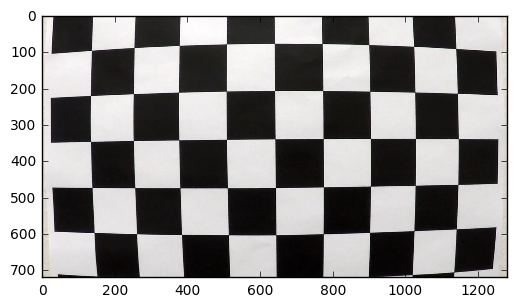

In [106]:
files = os.listdir("./camera_cal/")
img = mpimg.imread("./camera_cal/"+files[10])
plt.imshow(img)

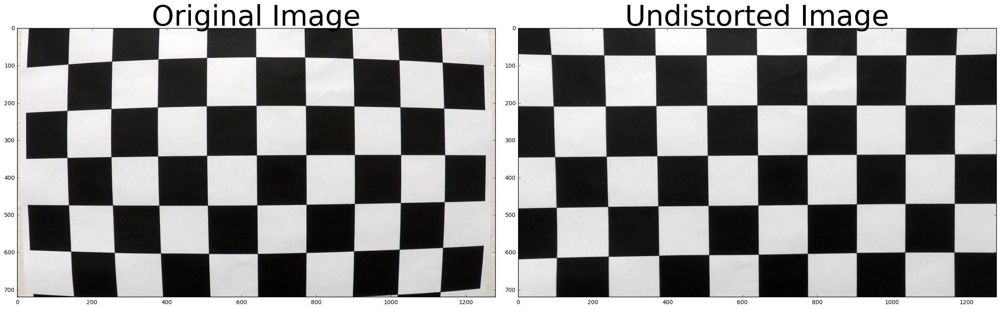

In [107]:
# sample undistortion
img = mpimg.imread("./camera_cal/"+files[10])
gray = cv2.cvtColor(img,cv2.COLOR_RGB2GRAY)
undist = undistort_image(gray)
# plot the source and undistorted image
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(img,cmap='gray')
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(undist,cmap='gray')
ax2.set_title('Undistorted Image', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

### Filters

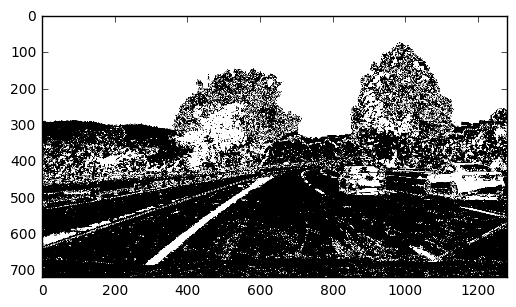

In [119]:
# open the stored camera calibration points for image processing
with open('advancedLane.pickle', 'rb') as handle:
    cameraData = pickle.load(handle)
imp = cameraData['imagePoints']
objp = cameraData['objectPoints']

# Validate the filters
files = os.listdir("./test_images/")
img = mpimg.imread("./test_images/"+files[3])
undist,filteredImg = applyFilters(img)
plt.imshow(filteredImg,cmap='gray')

### Undistort and unwarp the image

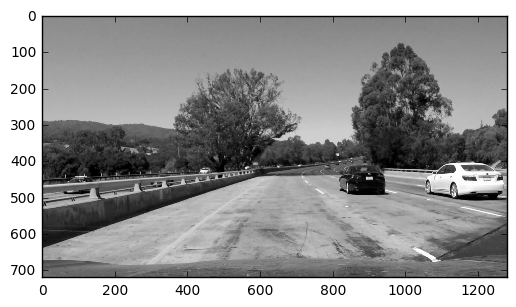

In [149]:
files = os.listdir("./test_images/")
newIMG = mpimg.imread("./test_images/"+files[3])
gray = cv2.cvtColor(newIMG,cv2.COLOR_RGB2GRAY)
plt.imshow(gray, cmap='gray')

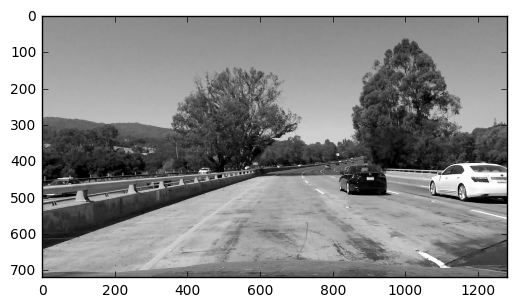

In [150]:
undist = undistort_image(gray)
plt.imshow(undist, cmap='gray')

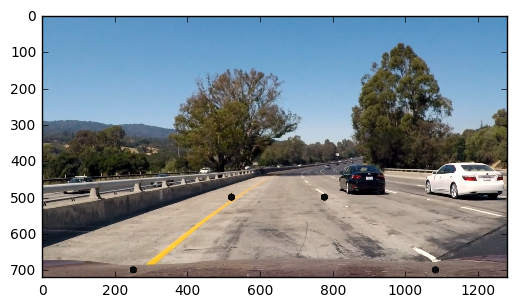

In [71]:
# plot points on image to target for perspective transformation
files = os.listdir("./test_images/")
newIMG = mpimg.imread("./test_images/"+files[3])
cv2.circle(newIMG,(250,700), 10, (10,10,10), -1)
cv2.circle(newIMG,(1080,700), 10, (10,10,10), -1)
cv2.circle(newIMG,(520,500), 10, (10,10,10), -1)
cv2.circle(newIMG,(775,500), 10, (10,10,10), -1)
plt.imshow(newIMG)

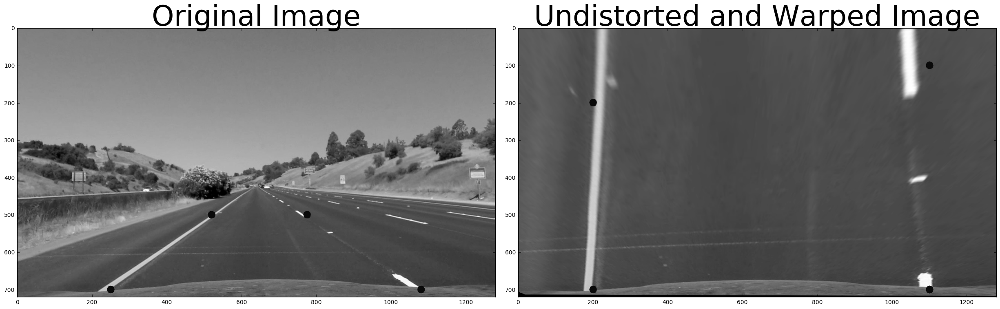

In [152]:
# open the stored camera calibration points for image processing
with open('advancedLane.pickle', 'rb') as handle:
    cameraData = pickle.load(handle)
imp = cameraData['imagePoints']
objp = cameraData['objectPoints']

# validatet the perspective transformation
files = os.listdir("./test_images/")
newIMG = mpimg.imread("./test_images/"+files[6])
gray = cv2.cvtColor(newIMG,cv2.COLOR_RGB2GRAY)
undist = undistort_image(gray)
top_down, perspective_M = corners_unwarp(undist)

# plot the images and points to validate transformation
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
cv2.circle(undist,(250,700), 10, (10,10,10), -1)
cv2.circle(undist,(1080,700), 10, (10,10,10), -1)
cv2.circle(undist,(520,500), 10, (10,10,10), -1)
cv2.circle(undist,(775,500), 10, (10,10,10), -1)
ax1.imshow(undist,cmap='gray')
ax1.set_title('Original Image', fontsize=50)


cv2.circle(top_down,(200,700), 10, (10,10,10), -1)
cv2.circle(top_down,(200,200), 10, (10,10,10), -1)
cv2.circle(top_down,(1100,100), 10, (10,10,10), -1)
cv2.circle(top_down,(1100,700), 10, (10,10,10), -1)
ax2.imshow(top_down,cmap='gray')
ax2.set_title('Undistorted and Warped Image', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

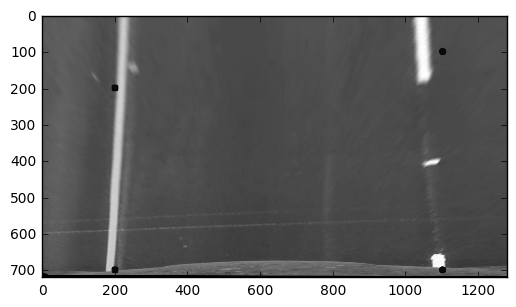

In [153]:
plt.imshow(top_down,cmap='gray')

### Lane Detection

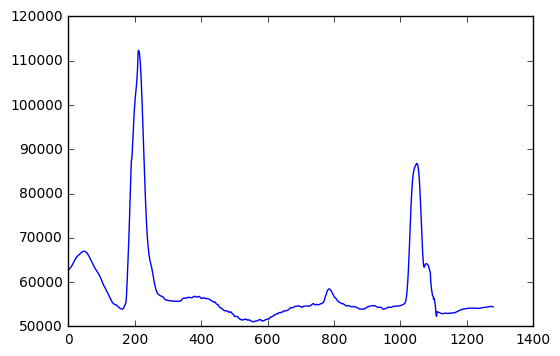

In [111]:
histogram = np.sum(top_down[:top_down.shape[0],:], axis=0)
plt.plot(histogram)

"\nmargin = 100\nleft_line_window1 = np.array([np.transpose(np.vstack([left_fitx-margin, ploty]))])\nleft_line_window2 = np.array([np.flipud(np.transpose(np.vstack([left_fitx+margin, ploty])))])\nleft_line_pts = np.hstack((left_line_window1, left_line_window2))\nright_line_window1 = np.array([np.transpose(np.vstack([right_fitx-margin, ploty]))])\nright_line_window2 = np.array([np.flipud(np.transpose(np.vstack([right_fitx+margin, ploty])))])\nright_line_pts = np.hstack((right_line_window1, right_line_window2))\n\n# Draw the lane onto the warped blank image\ncv2.fillPoly(out_img, np.int_([left_line_pts]), (0,255, 0))\ncv2.fillPoly(out_img, np.int_([right_line_pts]), (0,255, 0))\n#result = cv2.addWeighted(out_img, 1, window_img, 0.3, 0)\nplt.imshow(out_img)\nplt.plot(left_fitx, ploty, color='yellow')\nplt.plot(right_fitx, ploty, color='yellow')\nplt.xlim(0, 1280)\nplt.ylim(720, 0)\n"

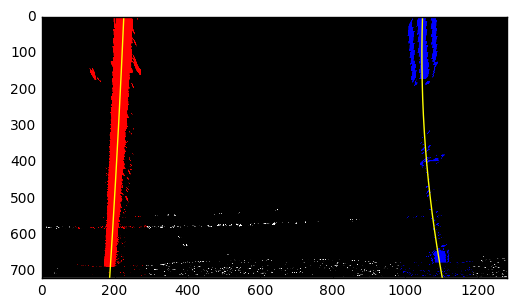

In [123]:
# validatet the lane line search
files = os.listdir("./test_images/")
img = mpimg.imread("./test_images/"+files[6])
undist,filtered = applyFilters(img)
top_down, perspective_M = corners_unwarp(filtered)


left_base,right_base,left_fit,right_fit,left_lane_inds,right_lane_inds,nonzeroy,nonzerox = first_frame_window(top_down)
ploty,left_fitx,right_fitx,leftx,righx = fitLanes(top_down,left_base,right_base,left_fit,right_fit)

# visualize
# Create an image to draw on and an image to show the selection window
out_img = np.dstack((top_down,top_down, top_down))*255
window_img = np.zeros_like(out_img)

# Color in left and right line pixels
out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]



# Generate x and y values for plotting
ploty = np.linspace(0, top_down.shape[0]-1, top_down.shape[0] )
left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]
plt.imshow(out_img, cmap="gray")
plt.plot(left_fitx, ploty, color='yellow')
plt.plot(right_fitx, ploty, color='yellow')
plt.xlim(0, 1280)
plt.ylim(720, 0)


### Image Processing Pipeline

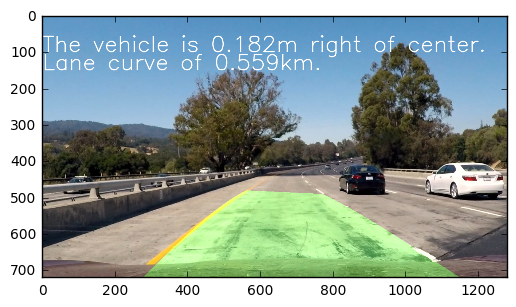

In [52]:
# open the stored camera calibration points for image processing
with open('advancedLane.pickle', 'rb') as handle:
    cameraData = pickle.load(handle)
imp = cameraData['imagePoints']
objp = cameraData['objectPoints']

# Validate the pipeline
test the lane finding pipeline on the test images
files = os.listdir("./test_images/")
img = mpimg.imread("./test_images/"+files[3])
leftCurve,vp, newImg = processImage(img)
imgText = "The vehicle is "+str(round(vp,3))+"m right of center."
font = cv2.FONT_HERSHEY_SIMPLEX
cv2.putText(newImg,imgText,(1,100), font, 2,(255,255,255),2,cv2.LINE_AA)
imgText = "Lane curve of "+str(round(leftCurve*.001,4))+"km."
cv2.putText(newImg,imgText,(1,150), font, 2,(255,255,255),2,cv2.LINE_AA)
plt.imshow(newImg)

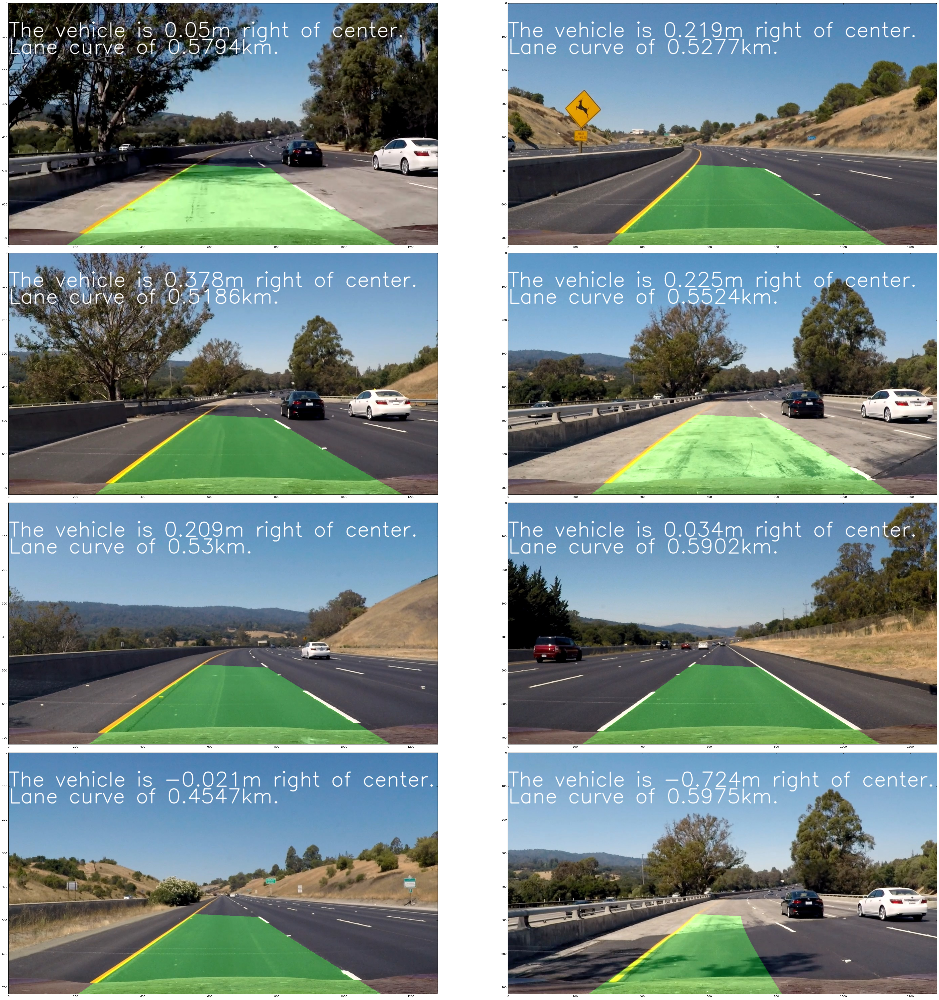

In [143]:
# process and plot all images
files = os.listdir("./test_images/")
f, ((ax1,ax2),(ax3,ax4),(ax5,ax6),(ax7,ax8)) = plt.subplots(4,2,figsize=(50, 50))
f.tight_layout()
ims = []
count = 1
for f in files:
    img = mpimg.imread("./test_images/"+f)
    leftCurve,vp, newImg = processImage(img)
    imgText = "The vehicle is "+str(round(vp,3))+"m right of center."
    font = cv2.FONT_HERSHEY_SIMPLEX
    cv2.putText(newImg,imgText,(1,100), font, 2,(255,255,255),2,cv2.LINE_AA)
    imgText = "Lane curve of "+str(round(leftCurve*.001,4))+"km."
    cv2.putText(newImg,imgText,(1,150), font, 2,(255,255,255),2,cv2.LINE_AA)
    ims.append(newImg)

ax1.imshow(ims[0])
ax2.imshow(ims[1])
ax3.imshow(ims[2])
ax4.imshow(ims[3])
ax5.imshow(ims[4])
ax6.imshow(ims[5])
ax7.imshow(ims[6])
ax8.imshow(ims[7])
#plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
plt.savefig("testLanes.png")

### Process the videos

In [154]:
# open the stored camera calibration points for image processing
with open('advancedLane.pickle', 'rb') as handle:
    cameraData = pickle.load(handle)
imp = cameraData['imagePoints']
objp = cameraData['objectPoints']
# instantiate lists to hold left and right lane objects for tracking
leftLines = []
rightLines = []
# process the video
video_output = 'projectOutput_p4.mp4'
clip1 = VideoFileClip("project_video.mp4")
white_clip = clip1.fl_image(processMovie) #NOTE: this function expects color images!!
%time white_clip.write_videofile(video_output, audio=False)

[MoviePy] >>>> Building video projectOutput_p4.mp4
[MoviePy] Writing video projectOutput_p4.mp4



  0%|          | 1/1261 [00:01<23:48,  1.13s/it]
Exception in thread Thread-4:
Traceback (most recent call last):
  File "/usr/lib/python3.5/threading.py", line 914, in _bootstrap_inner
    self.run()
  File "/home/joseph/py3_kernel/lib/python3.5/site-packages/tqdm/_tqdm.py", line 102, in run
    for instance in self.tqdm_cls._instances:
  File "/home/joseph/py3_kernel/lib/python3.5/_weakrefset.py", line 60, in __iter__
    for itemref in self.data:
RuntimeError: Set changed size during iteration

100%|█████████▉| 1260/1261 [24:27<00:01,  1.11s/it]


[MoviePy] Done.
[MoviePy] >>>> Video ready: projectOutput_p4.mp4 

CPU times: user 26min 1s, sys: 5min 4s, total: 31min 5s
Wall time: 24min 29s
